# Week 7<br>Analyzing and Visualizing Large Datasets

Mar 20, 2019

## Housekeeping

- Assignment #5 will be out Friday and due in two weeks
- Covers web scraping (last week) and working with large data (today)

## Today: working with big data

**By example:**
- Open Street Map data
- Census data
- NYC taxi cab trips

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import cartopy.crs as ccrs

## The data we'll need

- NYC taxi trips: https://s3.amazonaws.com/datashader-data/nyc_taxi_wide.parq
- 2010 Census data: http://s3.amazonaws.com/datashader-data/census2010.parq.zip

In [2]:
urls = ['https://s3.amazonaws.com/datashader-data/nyc_taxi_wide.parq',
       'http://s3.amazonaws.com/datashader-data/census2010.parq.zip']

In [3]:
import zipfile
import os
import urllib
    
def download_data(url, out_dir="data"):
    """
    Download (and unzip) data files to the "data" directory in 
    the current working directory.
    """
    if not os.path.exists(out_dir):
        os.makedirs(out_dir)
    
    target = os.path.join(out_dir, os.path.split(url)[-1])
    urllib.request.urlretrieve(url, target)
    
    if target.endswith('.zip'):
        with zipfile.ZipFile(target, "r") as zip_ref:
            zip_ref.extractall(out_dir)

In [173]:
# download the needed data files
# NOTE: these files are large and will take awhile to download
for url in urls:
    print("downloading %s..." %url)
    download_data(url, out_dir="data")

downloading https://s3.amazonaws.com/datashader-data/nyc_taxi_wide.parq...
downloading http://s3.amazonaws.com/datashader-data/census2010.parq.zip...


## The pyViz ecosystem

<center>
    <img src=attachment:Screen%20Shot%202019-03-20%20at%202.39.51%20AM.png width=800/>
</center>
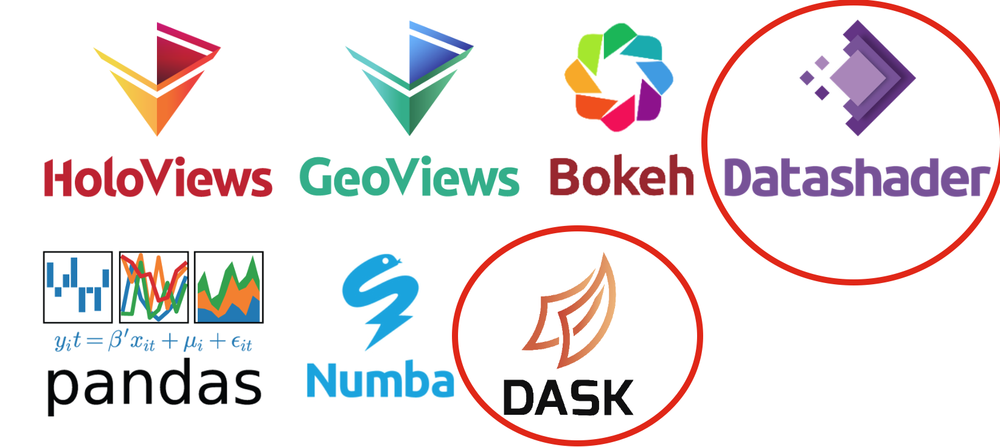

## Dask

Out-of-core (larger-than-memory) operations in Python

**Extends the maximum file size from the size of memory to the size of your hard drive**

## The key: lazy evaluation

Dask stores does not evaluate expressions immediately — rather it stores a *task graph* of the necessary calculations.

## Numpy arrays

In [4]:
import numpy as np

# create an array of normally-distributed random numbers
a = np.random.randn(1000)

# multiply this array by a factor
b = a * 4

# find the minimum value
b_min = b.min()
print(b_min)

-11.73724664645265


Dask arrays mirror the numpy array syntax...but don't perform the calculation right away.

In [5]:
import dask.array as da

# create a dask array from the above array
a2 = da.from_array(a, chunks=200)

# multiply this array by a factor
b2 = a2 * 4

# find the minimum value
b2_min = b2.min()
print(b2_min)

dask.array<amin-aggregate, shape=(), dtype=float64, chunksize=()>


We need to explicitly call the `compute()` function to evaluate the expression. We get the same result as the non-lazy numpy result.

In [6]:
b2_min.compute()

-11.73724664645265

## Dask dataframes

- Syntax mirrors the Pandas DataFrame object
- Uses the task graph functionality to provides a unified interface to multiple pandas DataFrame objects.

<center>
    <img src=attachment:Screen%20Shot%202019-03-20%20at%202.58.36%20AM.png width=400/>
</center>
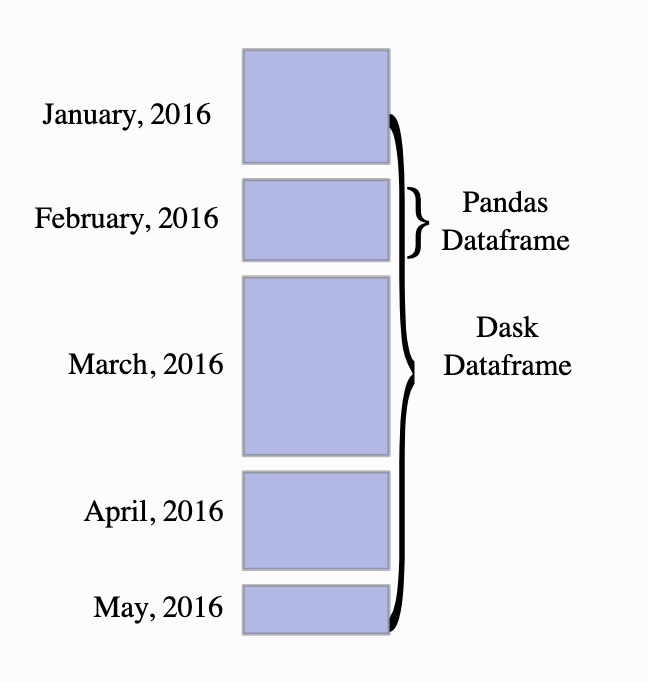

## Enables out-of-core operations

Pandas DataFrames don't need to fit into memory...when evaluating an expression, dask will load the data into memory when necessary.

## Let's try it out

Loading 1 billion Open Street Map points...

[Source](https://blog.openstreetmap.org/2012/04/01/bulk-gps-point-data/)

In [7]:
import dask.dataframe as dd

In [8]:
df = dd.read_parquet('./data/osm-1billion.snappy.parq')
df

,x,y
npartitions=37,,
,float32,float32
,...,...
...,...,...
,...,...
,...,...


**Note:** the data frame is sub-divided into 37 partitions and only one partition will be loaded into memory at a time.

In [9]:
# we can still get the head of the file quickly
df.head()

,x,y
0,16076076.0,-3627207.25
1,16832806.0,-4007314.75
2,15767838.0,-4390363.00
3,19442192.0,-4364528.00
4,16130131.0,-4548868.50


Data is latitude/longitude in Web Mercator coordinates

In [10]:
# getting the length means all of the data must be loaded though
print("number of rows = ", len(df))

number of rows =  1000050363


In [11]:
# calculating latitude/longitude
mean_x = df['x'].mean()
mean_y = df['y'].mean()

print(mean_x, mean_y)

dd.Scalar<series-..., dtype=float32> dd.Scalar<series-..., dtype=float32>


In [12]:
# evaluate the expressions
print("mean x = ", mean_x.compute())

mean x =  2731831.8241066746


In [13]:
# evaluate the expressions
print("mean y = ", mean_y.compute())

mean y =  5801828.8859780235


## Now let's visualize the points...but how?

## Not with matplotlib...

Matplotlib struggles with only hundreds of points

## Enter Datashader

"Turns even the largest data into images, accurately"

## Steps

1. Aggregate data onto a pixelized image
1. Map aggregated data to colors to properly represent density of data

First, if you have 16GB of RAM, the billion points will fit into memory, so let's force dask to load all the data at once. 

If your machine doesn't have the memory, the plotting will just take a bit longer.

In [ ]:
# force dask to load our data into memory
df = df.persist()

In [ ]:
# Web Mercator bounds
bound = 20026376.39
bounds = dict(x_range = (-bound, bound), y_range = (int(-bound*0.4), int(bound*0.6)))

# widht and height
plot_width = 900
plot_height = int(plot_width*0.5)

In [ ]:
import datashader as ds
from colorcet import fire
from datashader.colors import Greys9, viridis, inferno
import datashader.transfer_functions as tf

In [ ]:
# setup the canvas
canvas = ds.Canvas(plot_width=plot_width, plot_height=plot_height, **bounds)

# aggregate the points into pixels
agg = canvas.points(df, 'x', 'y', ds.count())

In [ ]:
# perform the shade operation
img = tf.shade(agg, cmap=fire)
tf.set_background(img, "black")

## Remove noise from pixels with low counts

## The world according to Open Street Map contributors

In [ ]:
selected = agg.where(agg > 15)
tf.set_background(tf.shade(selected, cmap=fire),"black")

## Part 1: revisiting the census dot map

We can use datashader to visualize all 300 million census dots produced as part of the [Cooper Center racial dot map](https://demographics.coopercenter.org/Racial-Dot-Map).

In [ ]:
# load the data
df = dd.read_parquet('./data/census2010.parq')
df = df.persist()

In [ ]:
df.head()

In [ ]:
print("number of rows =", len(df))

Set up bounds for major cities and USA:

**Important: datashader requires Web Mercator coordinates and has a utility function to convert from latitude/longitude**

In [ ]:
from datashader.utils import lnglat_to_meters as webm

USA           = ((-124.72,  -66.95), (23.55, 50.06))
LakeMichigan  = (( -91.68,  -83.97), (40.75, 44.08))
Chicago       = (( -88.29,  -87.30), (41.57, 42.00))
Chinatown     = (( -87.67,  -87.63), (41.84, 41.86))
NewYorkCity   = (( -74.39,  -73.44), (40.51, 40.91))
LosAngeles    = ((-118.53, -117.81), (33.63, 33.96))
Houston       = (( -96.05,  -94.68), (29.45, 30.11))
Austin        = (( -97.91,  -97.52), (30.17, 30.37))
NewOrleans    = (( -90.37,  -89.89), (29.82, 30.05))
Atlanta       = (( -84.88,  -84.04), (33.45, 33.84))
Philly        = (( -75.28,  -74.96), (39.86, 40.14))


x_range,y_range = [list(r) for r in webm(*USA)]
plot_width  = int(900)
plot_height = int(plot_width*7.0/12)

## First, visualize the population density

## How about a linear color scale?

/Users/nhand/anaconda3/envs/py37/lib/python3.6/site-packages/datashader/utils.py:348: FutureWarning: `Series.cat.categorical` has been deprecated. Use the attributes on 'Series.cat' directly instead.
  ordered=col.cat.categorical.ordered)


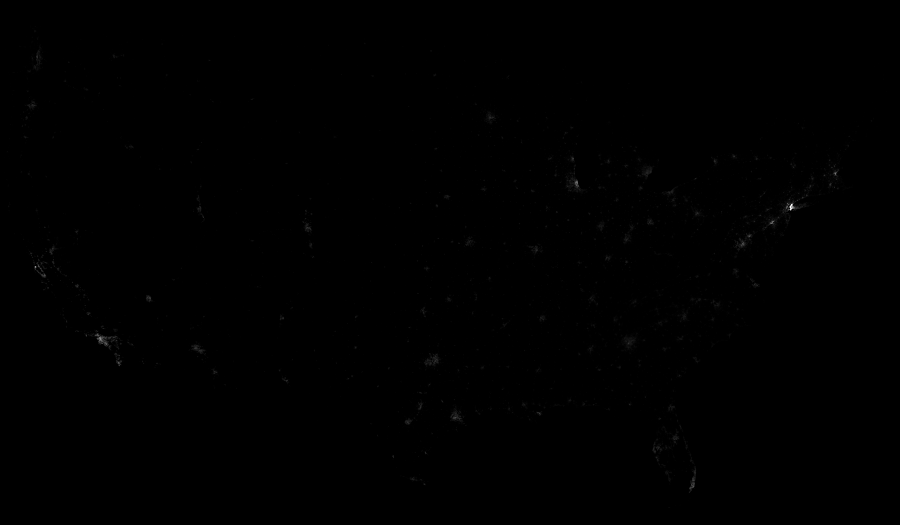

In [200]:
cvs = ds.Canvas(plot_width, plot_height, *webm(*USA))
agg = cvs.points(df, 'easting', 'northing')

tf.set_background(tf.shade(agg, cmap = Greys9, how='linear'), 'black')

## Okay, what about a log scale?

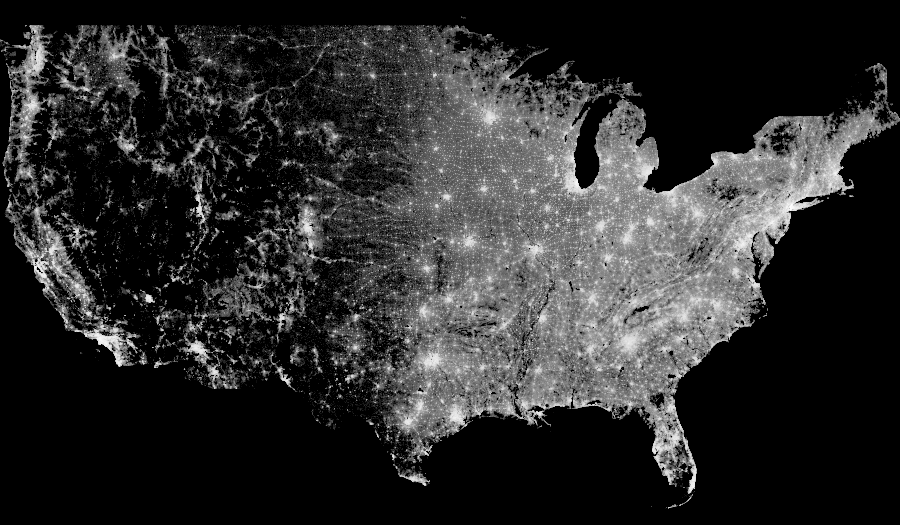

In [201]:
tf.set_background(tf.shade(agg, cmap=Greys9, how='log'), 'black')

## Let's use a perceptually uniform color map

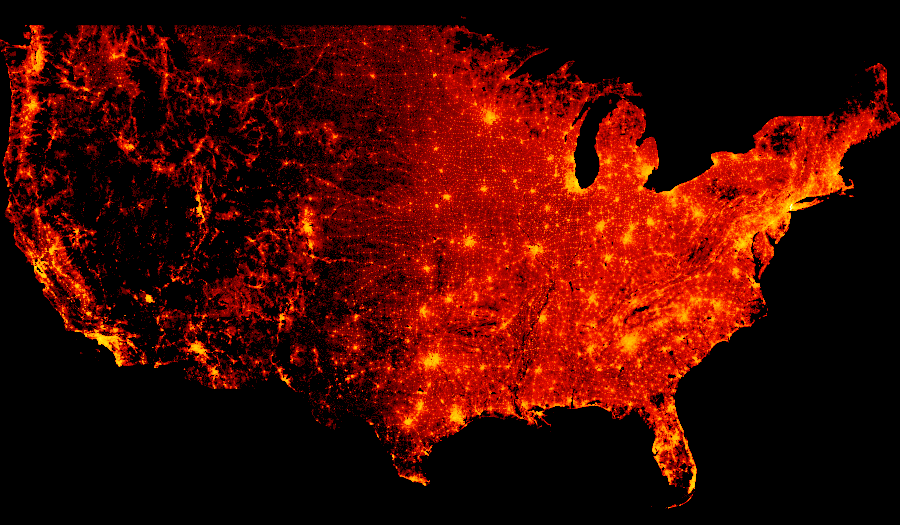

In [202]:
tf.set_background(tf.shade(agg, cmap=fire, how='log'), 'black')

## The best option: using the equal histogram method for shading

This is the default shading option for color mapping in datashader

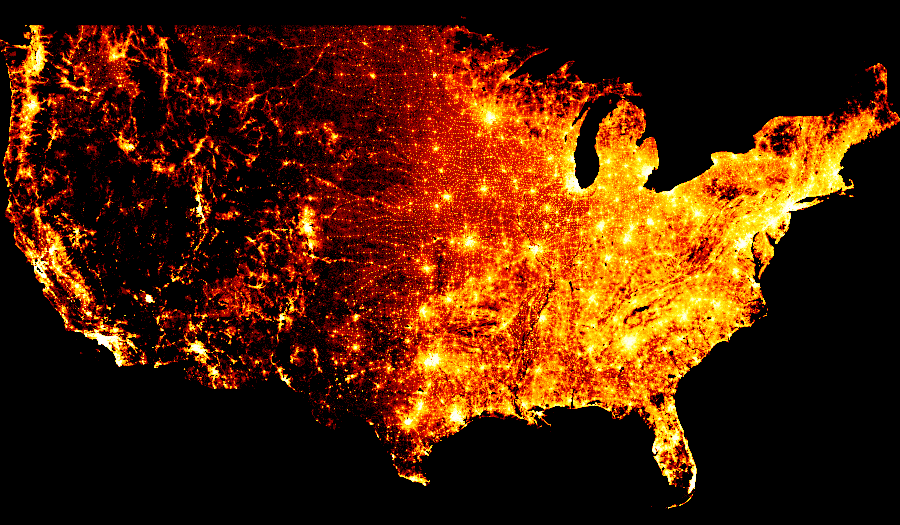

In [203]:
tf.set_background(tf.shade(agg, cmap=fire, how='eq_hist'), 'black')

## How about viridis?

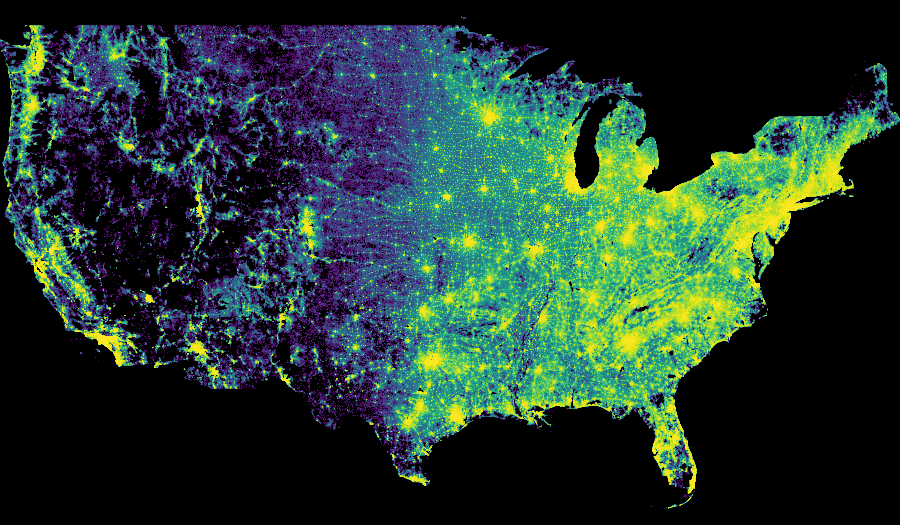

In [242]:
img = tf.set_background(tf.shade(agg, cmap=viridis, how='eq_hist'), 'black')
img

## How to save?

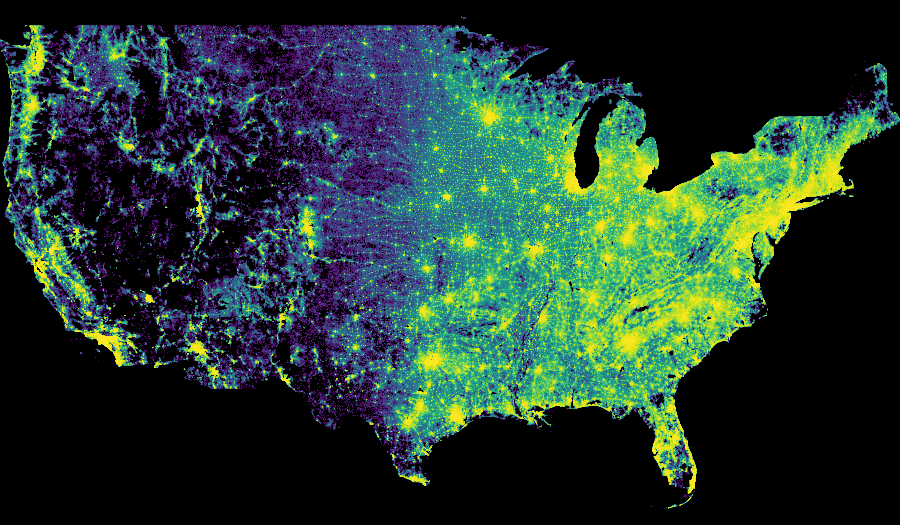

In [243]:
from datashader.utils import export_image
export_image(img, 'usa_census_viridis')

## Next, let's visualize race

Datashader can plot use different colors for different categories of data.

In [207]:
color_key = {'w':'aqua', 'b':'lime',  'a':'red', 'h':'fuchsia', 'o':'yellow' }

def create_image(longitude_range, latitude_range, w=plot_width, h=plot_height):
    x_range, y_range = webm(longitude_range, latitude_range)
    
    # setup the canvas
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    
    # aggregate, but this time count the "race" category
    agg = cvs.points(df, 'easting', 'northing', ds.count_cat('race'))
    
    # shade, using our color key
    img = tf.shade(agg, color_key=color_key, how='eq_hist')
    
    return tf.set_background(img, 'black')

## Let's visualize all 300 million points

/Users/nhand/anaconda3/envs/py37/lib/python3.6/site-packages/datashader/utils.py:348: FutureWarning: `Series.cat.categorical` has been deprecated. Use the attributes on 'Series.cat' directly instead.
  ordered=col.cat.categorical.ordered)


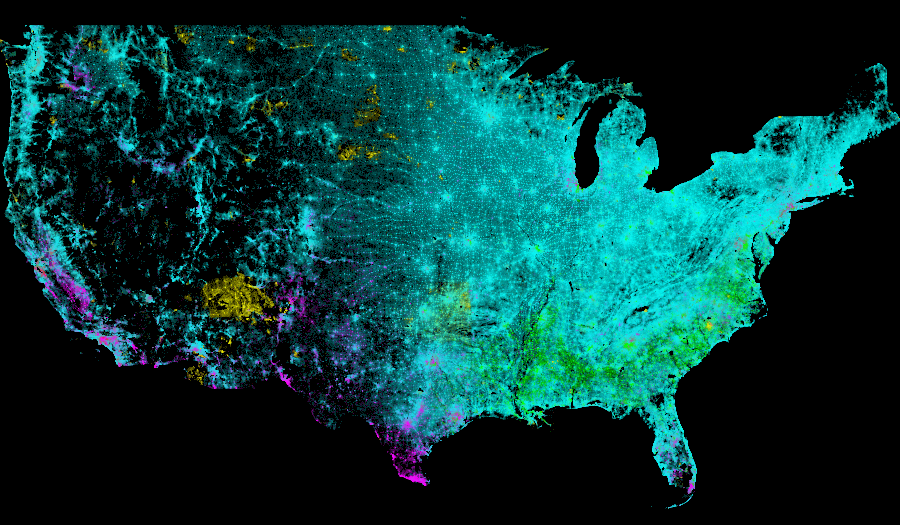

In [208]:
create_image(*USA)

## Let's zoom in on Philadelphia...

/Users/nhand/anaconda3/envs/py37/lib/python3.6/site-packages/datashader/utils.py:348: FutureWarning: `Series.cat.categorical` has been deprecated. Use the attributes on 'Series.cat' directly instead.
  ordered=col.cat.categorical.ordered)


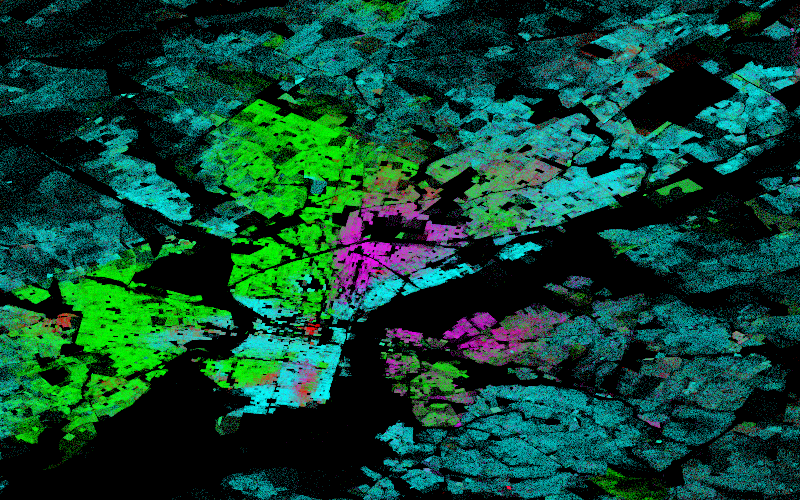

In [211]:
create_image(*Philly, w=800, h=500)

## What about other cities?

Exercise: use the bounding boxes provided earlier to explore racial patterns across various major cities

## Can we learn more than just population density and race?

The aggregate object can be sliced to examine specific aspects of the data.

## Where do African Americans live?

/Users/nhand/anaconda3/envs/py37/lib/python3.6/site-packages/datashader/utils.py:348: FutureWarning: `Series.cat.categorical` has been deprecated. Use the attributes on 'Series.cat' directly instead.
  ordered=col.cat.categorical.ordered)


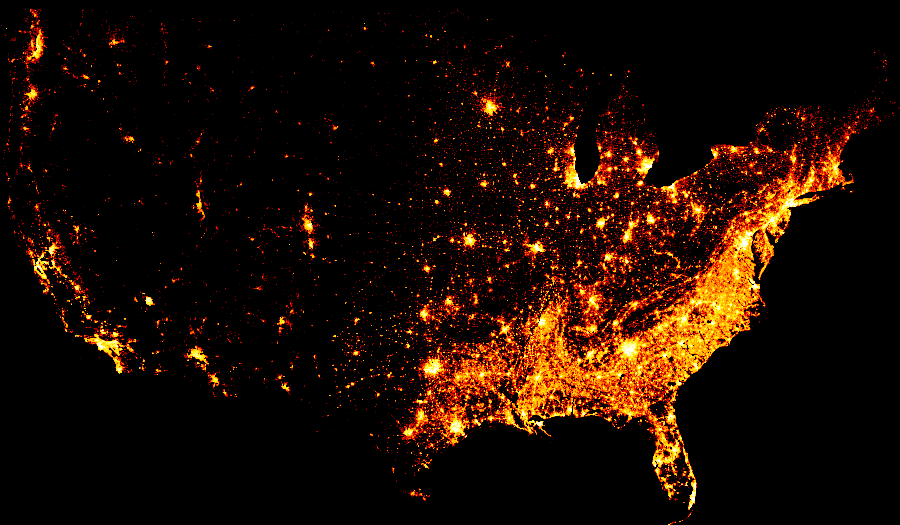

In [215]:
# setup canvas
cvs = ds.Canvas(plot_width=plot_width, plot_height=plot_height)

# aggregate and count race category
aggc = cvs.points(df, 'easting', 'northing', ds.count_cat('race'))

# select only African Americans
agg_b = aggc.sel(race='b')

# and plot
tf.set_background(tf.shade(agg_b, cmap=fire, how='eq_hist'), "black")

## How to identify diverse areas?

Select pixels where each race has a non-zero count

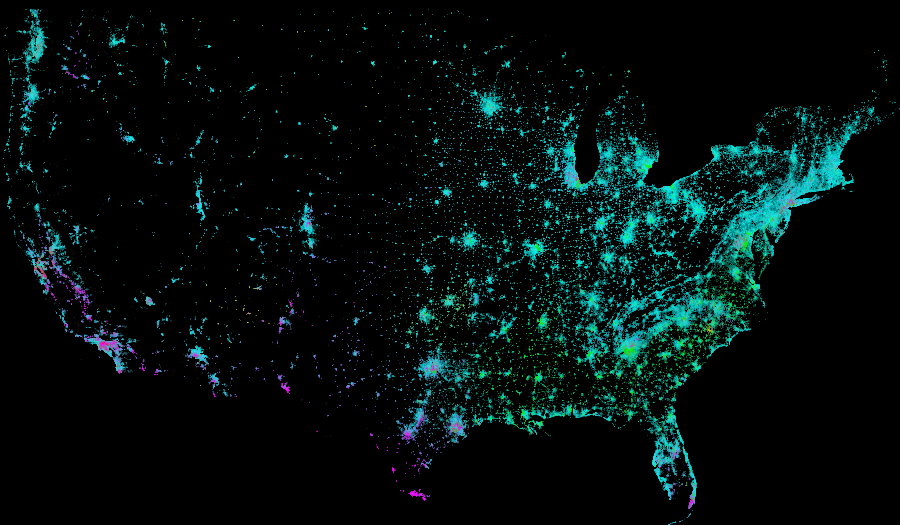

In [216]:
# select diverse areas
diverse_selection = (aggc.sel(race=['w', 'b', 'a', 'h']) > 0).all(dim='race')

# get the new aggregate 
agg2 = aggc.where(diverse_selection).fillna(0)

# and shade using our color key
tf.set_background(tf.shade(agg2, color_key=color_key, how='eq_hist'),"black")

## Areas where there are more African Americans than whites?

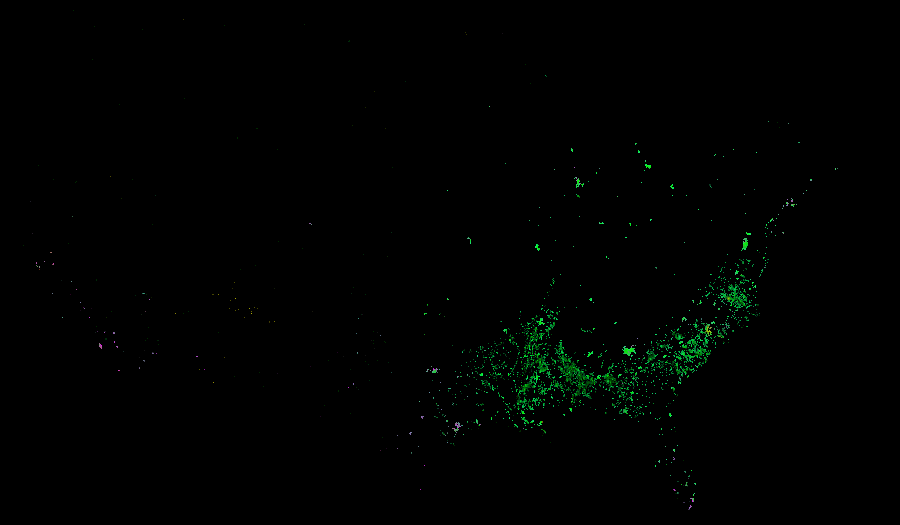

In [217]:
selection = aggc.sel(race='w') < aggc.sel(race='b')
agg2 = aggc.where(selection).fillna(0)
tf.set_background(tf.shade(agg2, color_key=color_key, how='eq_hist'),"black")

## Now let's make it interactive!

Enter Holoviews

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
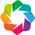

In [253]:
import holoviews as hv
import geoviews as gv
from holoviews.operation.datashader import datashade
hv.extension("bokeh")

In [220]:
# a holoview Points data set
points = hv.Points(df, kdims=['easting', 'northing'])

# shaded 
census = datashade(points, cmap=fire).opts(width=900, height=600)

# background tile
bg = gv.tile_sources.CartoDark

bg * census

/Users/nhand/anaconda3/envs/py37/lib/python3.6/site-packages/datashader/utils.py:348: FutureWarning: `Series.cat.categorical` has been deprecated. Use the attributes on 'Series.cat' directly instead.
  ordered=col.cat.categorical.ordered)


:DynamicMap   []
   :Overlay
      .WMTS.I :WMTS   [Longitude,Latitude]
      .RGB.I  :RGB   [easting,northing]   (R,G,B,A)

## We can visualize color-coded race interactively as well

In [221]:
# specify race as part of "vdims" 
points = hv.Points(df, kdims=['easting', 'northing'], vdims=['race'])

# similar syntax for color key and aggregator
race = datashade(points, color_key=color_key, aggregator=ds.count_cat('race'))

# combine images
img = (bg * race)
img.opts(width=900, height=700)

/Users/nhand/anaconda3/envs/py37/lib/python3.6/site-packages/datashader/utils.py:348: FutureWarning: `Series.cat.categorical` has been deprecated. Use the attributes on 'Series.cat' directly instead.
  ordered=col.cat.categorical.ordered)


:DynamicMap   []
   :Overlay
      .WMTS.I :WMTS   [Longitude,Latitude]
      .RGB.I  :RGB   [easting,northing]   (R,G,B,A)

## Exploring gerrymandering

We can easily overlay Congressional districts on our map...

Load the shape file into GeoViews:

In [222]:
shape_path = './data/cb_2015_us_cd114_5m'
districts = gv.Shape.from_shapefile(shape_path, crs=ccrs.PlateCarree())
districts = gv.project(districts)

In [223]:
districts = districts.opts(line_color='white')
img = bg * race * districts
img.opts(width=900, height=700)

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [easting,northing]   (R,G,B,A)
      .Polygons.I :Polygons   [Longitude,Latitude]

## Part 2: NYC taxi data

12 million tax trips from 2015...

In [224]:
ddf = dd.read_parquet("./data/nyc_taxi_wide.parq").persist()

print('%s Rows' % len(ddf))
print('Columns:', list(ddf.columns))

11842094 Rows
Columns: ['tpep_pickup_datetime', 'tpep_dropoff_datetime', 'passenger_count', 'trip_distance', 'pickup_x', 'pickup_y', 'dropoff_x', 'dropoff_y', 'fare_amount', 'tip_amount', 'dropoff_hour', 'pickup_hour']


In [59]:
ddf.head()

,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_x,pickup_y,dropoff_x,dropoff_y,fare_amount,tip_amount,dropoff_hour,pickup_hour
0,2015-01-15 19:05:39,2015-01-15 19:23:42,1,1.59,-8236963.0,4975552.5,-8234835.5,4975627.0,12.0,3.25,19,19
1,2015-01-10 20:33:38,2015-01-10 20:53:28,1,3.30,-8237826.0,4971752.5,-8237020.5,4976875.0,14.5,2.00,20,20
2,2015-01-10 20:33:38,2015-01-10 20:43:41,1,1.80,-8233561.5,4983296.5,-8232279.0,4986477.0,9.5,0.00,20,20
3,2015-01-10 20:33:39,2015-01-10 20:35:31,1,0.50,-8238654.0,4970221.0,-8238124.0,4971127.0,3.5,0.00,20,20
4,2015-01-10 20:33:39,2015-01-10 20:52:58,1,3.00,-8234433.5,4977363.0,-8238107.5,4974457.0,15.0,0.00,20,20


In [225]:
points = hv.Points(ddf, kdims=['dropoff_x', 'dropoff_y'])

In [228]:
datashade(points, cmap=fire).opts(width=700, height=600, bgcolor="black")

:DynamicMap   []
   :RGB   [dropoff_x,dropoff_y]   (R,G,B,A)

## Comparing pickups and dropoffs

- Pixels with more pickups: red
- Pixels with more dropoffs: blue

In [238]:
NYC = x_range, y_range = ((-8242000,-8210000), (4965000,4990000))
plot_width  = int(750)
plot_height = int(plot_width//1.2)

def merged_images(x_range, y_range, w=plot_width, h=plot_height, how='eq_hist'):
    
    # the canvas
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    
    # pick ups
    picks = cvs.points(ddf, 'pickup_x',  'pickup_y',  ds.count('passenger_count'))
    
    # drop offs
    drops = cvs.points(ddf, 'dropoff_x', 'dropoff_y', ds.count('passenger_count'))
    
    # rename to same names
    drops = drops.rename({'dropoff_x': 'x', 'dropoff_y': 'y'})
    picks = picks.rename({'pickup_x': 'x', 'pickup_y': 'y'})
    
    # more drop offs than pick ups
    more_drops = tf.shade(drops.where(drops > picks), cmap=["darkblue", 'cornflowerblue'], how=how)
    
    # more pick ups than drop offs
    more_picks = tf.shade(picks.where(picks > drops), cmap=["darkred", 'orangered'], how=how)
    
    # combine the images
    img = tf.stack(more_picks, more_drops)
    
    return tf.set_background(tf.dynspread(img, threshold=0.3, max_px=4), 'black')

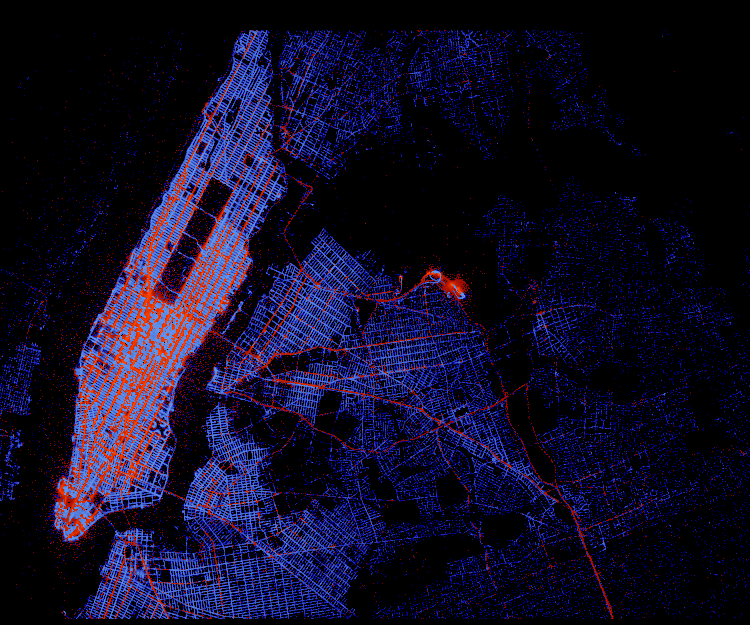

In [239]:
merged_images(*NYC)

Takeaway: pickups occur more often on major roads, and dropoffs on smaller roads

## Let's generate some time-lapse GIFs

Powerful tool for visualizing trends over time

## Define some functions...

In [248]:
def create_image(df, x_range, y_range, w=plot_width, h=plot_height, cmap=fire):
    
    # create the canvas
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    
    # plot dropoff positions, coutning number of passengers
    agg = cvs.points(df, 'dropoff_x', 'dropoff_y',  ds.count('passenger_count'))
    
    # shade
    img = tf.shade(agg, cmap=cmap, how='eq_hist')
    
    # return an PIL image
    return tf.set_background(img, "black").to_pil()

In [249]:
def convert_to_12hour(hr24):
    """
    Convert from 24 hr to 12 hr.
    """
    from datetime import datetime
    d = datetime.strptime(str(hr24), "%H")
    return d.strftime("%I %p")

In [252]:
def plot_dropoffs_by_hour(fig, df, hour):
    """
    Plot the dropoffs for particular hour
    """
    # generate the datashader image
    df = df.loc[df['dropoff_hour']==hour]
    img = create_image(df, *NYC)
    
    # plot the image on a matplotlib axes
    plt.clf()
    ax = fig.gca()
    ax.imshow(img)
    ax.axis('off')
    
    # add a text label for the hour
    ax.text(0.05, 0.9, convert_to_12hour(hour), color='white', 
            fontsize=40, ha='left', transform=ax.transAxes)
    
   
    # draw the figure and return the image
    fig.canvas.draw()   
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    
    return image

## Use `imageio` to convert to save images as a GIF

In [ ]:
import imageio

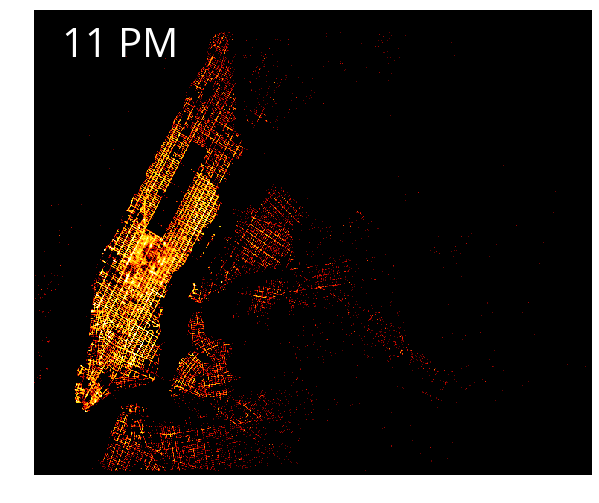

In [251]:
# create a figure
fig, ax = plt.subplots(figsize=(10,10))

# save the GIF
hours = range(24)
imageio.mimsave('dropoffs.gif', [plot_dropoffs_by_hour(fig, ddf, hr) for hr in hours], fps=1);

## Analyzing hourly and weekly trends for taxis

In [256]:
df = pd.read_csv('./data/nyc_taxi_2016_by_hour.csv.gz', parse_dates=['Pickup_date'])

In [257]:
# create relevant time columns
df["Day & Hour"] = df["Pickup_date"].dt.strftime("%A %H:00")
df["Week of Year"] = df["Pickup_date"].dt.strftime("Week %W")
df["Date"] = df["Pickup_date"].dt.strftime("%Y-%m-%d")

In [258]:
heatmap = hv.HeatMap(df, kdims=["Day & Hour", "Week of Year"], vdims=["Pickup_Count", "Date"])

In [259]:
heatmap.opts(
    radial=True,  height=600, width=600, yticks=None, xmarks=7, ymarks=3, start_angle=np.pi*19/14, 
    xticks=("Friday", "Saturday", "Sunday", "Monday", "Tuesday", "Wednesday", "Thursday"), tools=['hover'])

:HeatMap   [Day & Hour,Week of Year]   (Pickup_Count,Date)

## Trends

- Taxi pickup counts are high between 7-9am and 5-10pm during weekdays which business hours as expected. In contrast, during weekends, there is not much going on until 11am.
- Friday and Saterday nights clearly stand out with the highest pickup densities as expected.
- Public holidays can be easily identified. For example, taxi pickup counts are comparetively low around Christmas and Thanksgiving.
- Weather phenomena also influence taxi service. There is a very dark blue stripe at the beginning of the year starting at Saterday 23rd and lasting until Sunday 24th. Interestingly, there was one of the biggest blizzards in the history of NYC.